Missed Trash Pickups

In this data question you will be working data of service request related to missed trash pickups from hubNashville, Metro Nashville government's comprehensive customer service system (https://hub.nashville.gov).

As part of Metro's contract with Red River Waste Solutions, failure to remedy an action or inaction will result in liquidated damages. One category of liquidated damages is related to chronic problems in any category of service at the same premises. A chronic problem is defined as more than one missed pickup for any address. The first missed pickup will not result in a fine; however, every subsequent missed pickup will result in a $200 fine.

Your job is to determine the total amount of damages due to missed pickups. Note that not all rows that you have been provided correspond to missed pickups and that you will need to ensure that you are only counting missed pickups.

Before you begin, explore the data. Cleaning and preparing the data for analysis is an important and necessary step.
Planning and communication are vital to success. This data and analysis are based on a real-world project.

After determining the total amount of damages, you can look at other questions:

In [4]:
# Import libraries
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import folium
from folium.plugins import DualMap
from folium.features import GeoJsonTooltip
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster

In [5]:
# Read in cleaned data file and basic info (Shout out Megan for the assist)
missed_pickups_df = pd.read_csv(r'../trash-haulers-lambda-landfills/missed_pickups.csv')
print(missed_pickups_df.shape)
print(missed_pickups_df.columns)
print(missed_pickups_df)

(19057, 15)
Index(['Request_Number', 'Date_Opened', 'Request', 'Description',
       'Incident_Address', 'Zip_Code', 'Trash_Hauler_x', 'Trash_Route',
       'Council_District', 'State_Plan_X', 'State_Plan_Y', 'Trash_Hauler_y',
       'missed_count', 'fines', 'Missed_by_Zip'],
      dtype='object')
       Request_Number Date_Opened                               Request  \
0               25274   11/1/2017  Trash - Curbside/Alley Missed Pickup   
1               25276   11/1/2017  Trash - Curbside/Alley Missed Pickup   
2               25307   11/1/2017  Trash - Curbside/Alley Missed Pickup   
3               25312   11/1/2017  Trash - Curbside/Alley Missed Pickup   
4               25327   11/1/2017            Trash Collection Complaint   
...               ...         ...                                   ...   
19052          267125   11/1/2019  Trash - Curbside/Alley Missed Pickup   
19053          267126   11/1/2019  Trash - Curbside/Alley Missed Pickup   
19054          267130   11

In [6]:
# Read in zipcodes geojson file
zipcodes = gpd.read_file(r'../trash-haulers-lambda-landfills/zipcodes.geojson')
print(zipcodes.crs)
print(zipcodes.shape)
print(zipcodes.columns)
print(zipcodes)

EPSG:4326
(56, 6)
Index(['zip', 'objectid', 'po_name', 'shape_stlength', 'shape_starea',
       'geometry'],
      dtype='object')
      zip objectid         po_name      shape_stlength        shape_starea  \
0   37115        1         MADISON  178783.02488886821  596553400.57885742   
1   37216        3       NASHVILLE  75820.997821400058  188884682.28344727   
2   37204        9       NASHVILLE  93180.292250425613  200664795.51708984   
3   37027       11       BRENTWOOD   159760.6942933173  174978422.04101562   
4   37064       18        FRANKLIN  28995.828320601937  46969608.005737305   
5   37143       23          PEGRAM  7047.8267580476522   1900364.756652832   
6   37080       42         JOELTON  2319.8074237329579  56522.611450195313   
7   37221       17       NASHVILLE   241372.3112694624  1266395059.4877319   
8   37072       47  GOODLETTSVILLE  225242.45424953851  1094968706.7701416   
9   37212       54       NASHVILLE  58759.243654332378  73920091.147705078   
10  37135  

What other types of complaints are there?

In [7]:
# Look at the different types of complaints
print("Complaint types and how many times they appear:")
print(missed_pickups_df['Request'].value_counts().head())

Complaint types and how many times they appear:
Request
Trash - Curbside/Alley Missed Pickup    15916
Trash - Backdoor                         2332
Trash Collection Complaint                809
Name: count, dtype: int64


Make a heat map that shows the most total missed pick ups and another that shows the total fines, each by zip code.

In [8]:
# Convert Zip_Code to string (object type)
missed_pickups_df['Zip_Code'] = missed_pickups_df['Zip_Code'].astype(str)

# Optional: remove any decimal point if it exists (like 10001.0 → 10001)
missed_pickups_df['Zip_Code'] = missed_pickups_df['Zip_Code'].str.split('.').str[0]

# Check the type
print(missed_pickups_df['Zip_Code'].dtype)
print(missed_pickups_df['Zip_Code'].head())

object
0    37218
1    37209
2    37207
3    37209
4    37203
Name: Zip_Code, dtype: object


In [9]:
# Group by Zip_Code and sum missed pickups and fines
zip_summary = missed_pickups_df.groupby('Zip_Code')[['missed_count', 'fines']].sum().reset_index()
print(zip_summary.head())
zip_summary.shape

  Zip_Code  missed_count   fines
0    37013          4939  539200
1    37027           314   30000
2    37076             4       0
3    37086             5     400
4    37115          2593  285200


(29, 3)

In [10]:
# Merge zipcodes GeoDataFrame with the summary table
zip_map = zipcodes.merge(zip_summary, left_on='zip', right_on='Zip_Code', how='left')

# Fill NaN with 0 (in case some zip codes have no data)
zip_map['missed_count'] = zip_map['missed_count'].fillna(0)
zip_map['fines'] = zip_map['fines'].fillna(0)

print(zip_map.head())

     zip objectid    po_name      shape_stlength        shape_starea  \
0  37115        1    MADISON  178783.02488886821  596553400.57885742   
1  37216        3  NASHVILLE  75820.997821400058  188884682.28344727   
2  37204        9  NASHVILLE  93180.292250425613  200664795.51708984   
3  37027       11  BRENTWOOD   159760.6942933173  174978422.04101562   
4  37064       18   FRANKLIN  28995.828320601937  46969608.005737305   

                                            geometry Zip_Code  missed_count  \
0  MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ...    37115        2593.0   
1  MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ...    37216        1346.0   
2  MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ...    37204        1236.0   
3  MULTIPOLYGON (((-86.81258 36.06319, -86.81263 ...    37027         314.0   
4  MULTIPOLYGON (((-87.02197 36.012, -87.0214 36....      NaN           0.0   

      fines  
0  285200.0  
1  111600.0  
2  122000.0  
3   30000.0  
4       0.0  


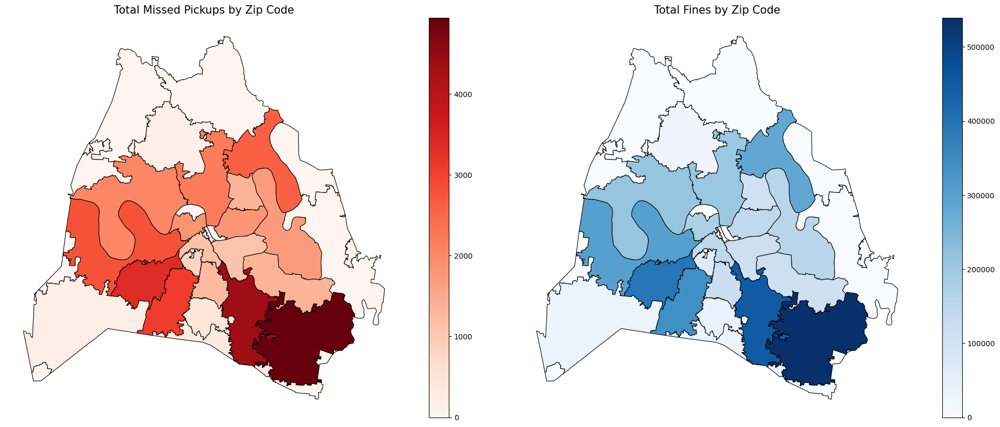

In [11]:
# Create side-by-side plots (1 row, 2 columns)
fig, axes = plt.subplots(1, 2, figsize=(20, 8))

# Left plot = missed pickups
zip_map.plot(column='missed_count',
             cmap='Reds',
             linewidth=0.8,
             edgecolor='black',
             legend=True,
             ax=axes[0])

axes[0].set_title('Total Missed Pickups by Zip Code', fontsize=15)
axes[0].axis('off')

# Right plot = fines
zip_map.plot(column='fines',
             cmap='Blues',
             linewidth=0.8,
             edgecolor='black',
             legend=True,
             ax=axes[1])

axes[1].set_title('Total Fines by Zip Code', fontsize=15)
axes[1].axis('off')

# Show both together
plt.tight_layout()
plt.show()

In [12]:
# Create base map centered on Nashville
nashville_missed_map = folium.Map(location=[36.1627, -86.7816], zoom_start=10, tiles="cartodbpositron")

# Choropleth for missed pickups
folium.Choropleth(
    geo_data=zip_map.to_json(),
    data=zip_map,
    columns=['zip', 'missed_count'],
    key_on='feature.properties.zip',
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Missed Pickups',
    name="Missed Pickups"
).add_to(nashville_missed_map)

# Tooltip (force it to only use missed_count)
folium.GeoJson(
    data=zip_map[['zip', 'missed_count', 'geometry']].to_json(),
    style_function=lambda feature: {
        'color': 'black',
        'weight': 0.5,
        'fillOpacity': 0
    },
    tooltip=folium.GeoJsonTooltip(
        fields=['zip', 'missed_count'],
        aliases=['Zip Code:', 'Missed Pickups:'],
        localize=True
    )
).add_to(nashville_missed_map)

nashville_missed_map

# Save missed pickups map
#nashville_missed_map.save("nashville_missed_pickups.html")

In [13]:
# New map for fines
nashville_fines_map = folium.Map(location=[36.1627, -86.7816], zoom_start=10, tiles="cartodbpositron")

# Choropleth for fines
folium.Choropleth(
    geo_data=zip_map.to_json(),
    data=zip_map,
    columns=['zip', 'fines'],
    key_on='feature.properties.zip',
    fill_color='Blues',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Fines ($)',
    name="Fines"
).add_to(nashville_fines_map)

# Tooltip (force it to only use fines)
folium.GeoJson(
    data=zip_map[['zip', 'fines', 'geometry']].to_json(),
    style_function=lambda feature: {
        'color': 'black',
        'weight': 0.5,
        'fillOpacity': 0
    },
    tooltip=folium.GeoJsonTooltip(
        fields=['zip', 'fines'],
        aliases=['Zip Code:', 'Total Fines: $'],
        localize=True
    )
).add_to(nashville_fines_map)

nashville_fines_map

# Save fines map
#nashville_fines_map.save("nashville_fines.html")

In [14]:
# Tried to overlay both maps with a toggle switch but couldn't get the colors to switch. Moved on due to time constraint.

# Base map centered on Nashville
nashville_map = folium.Map(location=[36.1627, -86.7816], zoom_start=10, tiles="cartodbpositron")

# Choropleth for missed pickups
folium.Choropleth(
    geo_data=zip_map.to_json(),
    data=zip_map,
    columns=['zip', 'missed_count'],
    key_on='feature.properties.zip',
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Missed Pickups',
    name="Missed Pickups"   # <- Layer name
).add_to(nashville_map)

# Tooltip for missed pickups
folium.GeoJson(
    data=zip_map[['zip', 'missed_count', 'geometry']].to_json(),
    name="Missed Pickups",
    style_function=lambda feature: {
        'color': 'black',
        'weight': 0.5,
        'fillOpacity': 0
    },
    tooltip=folium.GeoJsonTooltip(
        fields=['zip', 'missed_count'],
        aliases=['Zip Code:', 'Missed Pickups:'],
        localize=True
    )
).add_to(nashville_map)

# Choropleth for fines
folium.Choropleth(
    geo_data=zip_map.to_json(),
    data=zip_map,
    columns=['zip', 'fines'],
    key_on='feature.properties.zip',
    fill_color='Blues',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Fines ($)',
    name="Fines"   # <- Layer name
).add_to(nashville_map)

# Tooltip for fines
folium.GeoJson(
    data=zip_map[['zip', 'fines', 'geometry']].to_json(),
    name="Fines",
    style_function=lambda feature: {
        'color': 'black',
        'weight': 0.5,
        'fillOpacity': 0
    },
    tooltip=folium.GeoJsonTooltip(
        fields=['zip', 'fines'],
        aliases=['Zip Code:', 'Total Fines: $'],
        localize=True
    )
).add_to(nashville_map)

# Add layer control (toggle)
folium.LayerControl().add_to(nashville_map)

nashville_map

# Save map
#nashville_map.save("nashville_missed_and_fines.html")

In [15]:
# Joined visualizations for missed pickups and fines heatmaps using folium dual map.

# Create a dual map centered on Nashville
dual_map = DualMap(location=[36.1627, -86.7816], zoom_start=10, tiles="cartodbpositron")

# Choropleth for missed pickups (left)
folium.Choropleth(
    geo_data=zip_map.to_json(),
    data=zip_map,
    columns=['zip', 'missed_count'],
    key_on='feature.properties.zip',
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Missed Pickups'
).add_to(dual_map.m1)

# Tooltip for missed pickups
folium.GeoJson(
    data=zip_map[['zip', 'missed_count', 'geometry']].to_json(),
    style_function=lambda feature: {
        'color': 'black',   # border color
        'weight': 1,        # border thickness
        'fillOpacity': 0    # keep fill transparent (we already have the choropleth)
    },
    tooltip=folium.GeoJsonTooltip(
        fields=['zip', 'missed_count'],
        aliases=['Zip Code:', 'Missed Pickups:']
    )
).add_to(dual_map.m1)

# Choropleth for fines (right)
folium.Choropleth(
    geo_data=zip_map.to_json(),
    data=zip_map,
    columns=['zip', 'fines'],
    key_on='feature.properties.zip',
    fill_color='Blues',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Fines ($)'
).add_to(dual_map.m2)

# Tooltip for fines
folium.GeoJson(
    data=zip_map[['zip', 'fines', 'geometry']].to_json(),
    style_function=lambda feature: {
        'color': 'black',   # border color
        'weight': 1,
        'fillOpacity': 0
    },
    tooltip=folium.GeoJsonTooltip(
        fields=['zip', 'fines'],
        aliases=['Zip Code:', 'Total Fines: $']
    )
).add_to(dual_map.m2)

#dual_map.save("nashville_side_by_side.html")
dual_map

How do metro crews compare to the contractor's performance?

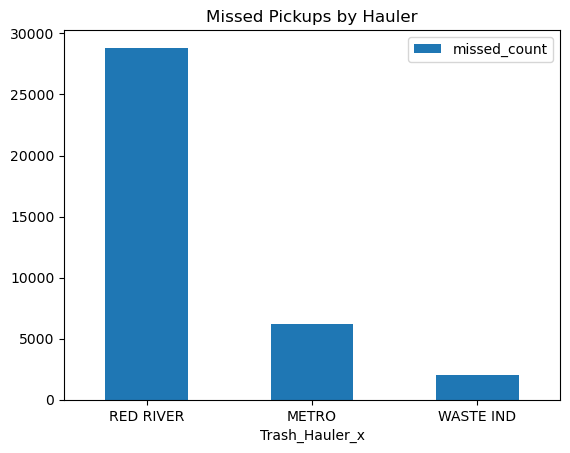

In [50]:
# Group by hauler type and sum missed pickups and fines
grouped_hauler = missed_pickups_df.groupby('Trash_Hauler_x')[['missed_count', 'fines']].sum().reset_index()

# Optional: sort to see best/worst
grouped_hauler = grouped_hauler.sort_values('missed_count', ascending=False)

# Quick bar chart
grouped_hauler.plot(x='Trash_Hauler_x', y='missed_count', kind='bar', title='Missed Pickups by Hauler', rot=0);

How much does each trash hauler owe?

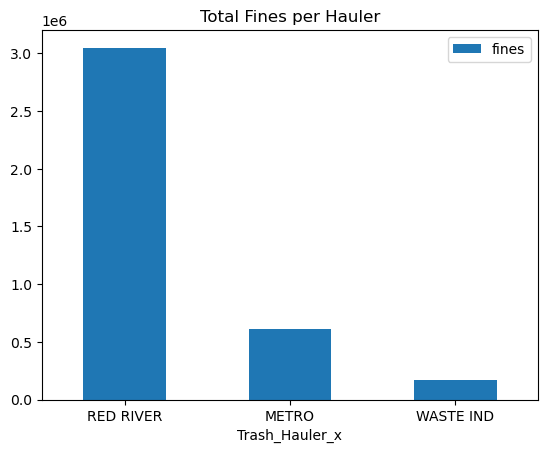

In [16]:
# Total fines per hauler
fines_per_hauler = missed_pickups_df.groupby('Trash_Hauler_x')['fines'].sum().reset_index()

# Sort descending to see who owes the most
fines_per_hauler = fines_per_hauler.sort_values('fines', ascending=False)

# Quick visualization
fines_per_hauler.plot(x='Trash_Hauler_x', y='fines', kind='bar', title='Total Fines per Hauler', rot=0);

What were the total missed pickup by route?

In [17]:
# Sum missed pickups by route
missed_by_route = missed_pickups_df.groupby('Trash_Route')['missed_count'].sum().reset_index()
# Sort descending to see who owes the most
missed_by_route = missed_by_route.sort_values('missed_count', ascending=False)
missed_by_route.head(10)

,Trash_Route,missed_count
133,4504,999
9,1303,771
38,2303,756
74,3302,720
150,9303,675
147,9208,667
64,3203,656
139,4510,646
42,2305,598
62,3201,583


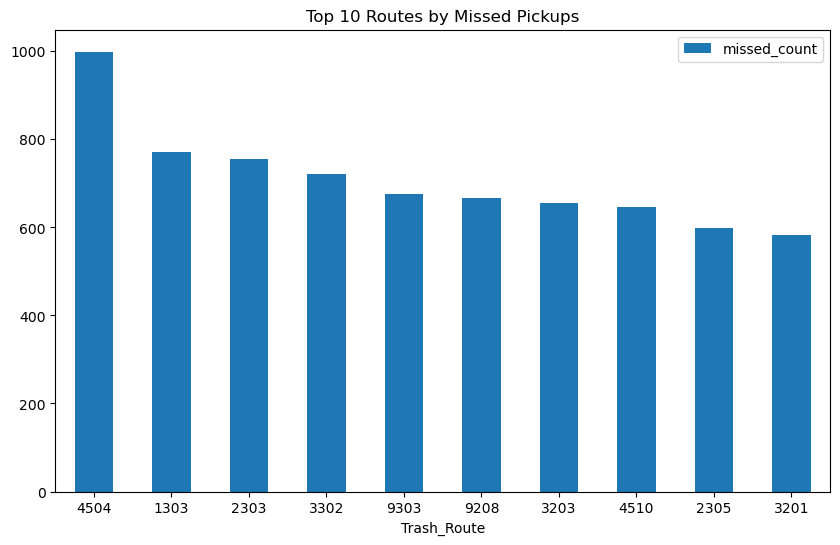

In [52]:
# Sort to find top 10 routes with most missed pickups
top_routes = missed_by_route.sort_values('missed_count', ascending=False).head(10)

#Plot top 10 routes
top_routes.plot(x='Trash_Route', y='missed_count', kind='bar', figsize=(10,6), title='Top 10 Routes by Missed Pickups', rot=0);